# Projeto 14: Deep Dream

Codificação adaptada da documentação do TensorFlow: https://www.tensorflow.org/beta/tutorials/generative/deepdream

Mais informações sobre a rede InceptionV3:https://cloud.google.com/tpu/docs/inception-v3-advanced?hl=pt-br

# Introdução a rede InceptionV3
> O Inception v3 é um modelo de reconhecimento de imagem que foi mostrado para alcançar mais de 78,1% de precisão no conjunto de dados do ImageNet. Esse modelo é o auge de muitas ideias desenvolvidas por vários pesquisadores ao longo dos anos. Ele é baseado no documento original["Rethinking the Inception Architecture for Computer Vision"](https://arxiv.org/abs/1512.00567) de Szegedy e outros autores. - Google
 
>O próprio modelo é composto de elementos básicos simétricos e assimétricos, incluindo convoluções, average pooling ,max pooling, concatenações, dropouts e camadas totalmente conectadas. A batch normalization é usada extensivamente em todo o modelo e aplicada às entradas de ativação. A perda é calculada usando Softmax. - Google

![inceptionV3](https://cloud.google.com/tpu/docs/images/inceptionv3onc--oview.png)

# Introdução a DeepDream

>DeepDream é um programa de visão computacional criado pelo engenheiro do Google Alexander Mordvintsev que usa uma rede neural convolucional para encontrar e aprimorar padrões em imagens via pareidolia algorítmica , criando assim uma aparência de sonho que lembra uma experiência psicodélica nas imagens deliberadamente superprocessadas. - Wikipédia

Após o treinamento da rede InceptionV3 a rede é executada ao contrário sendo solicitado a ajustar ligeiramente aimagem original
para que um determinado neurônio de saída (por exemplo, o de rostos ou certos animais) produza uma pontuação de confiança mais
alta ("subida do gradiente").

# Etapa 1: Importação das bibliotecas

In [43]:
%tensorflow_version 2.x
import tensorflow as tf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import random
tf.__version__
print(np.__version__)

1.19.5


# Etapa 2: Importação do modelo com pesos pré-treinados

A maioria dos modelos são uma série de camadas convolucionais seguidas por uma ou algumas camadas densas (ou totalmente conectadas).

*Include_top* permite selecionar se deseja ou não as camadas densas finais.

- As camadas convolucionais funcionam como extratores de recursos. Eles identificam uma série de padrões na imagem, e cada camada pode identificar padrões mais elaborados vendo padrões de padrões.

- As camadas densas são capazes de interpretar os padrões encontrados para classificar: esta imagem contém gatos, cães, carros, etc.

In [2]:
#top =  false para não ter as camadas de saida
base_model = tf.keras.applications.InceptionV3(include_top = False,
                                              weights = 'imagenet')

In [3]:
base_model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv2d (Conv2D)                (None, None, None,   864         ['input_1[0][0]']                
                                32)                                                               
                                                                                                  
 batch_normalization (BatchNorm  (None, None, None,   96         ['conv2d[0][0]']                 
 alization)                     32)                                                    

# Nota:
- O objetivo do algoritmo é selecionar uma camada para maximizar a loss function, que são as ativações
- Podemos selecionar qualquer camada, lembrando que as primeiras camadas possuem características mais simples (bordas) e camadas superiores possuem características mais complexas e detalhadas dos objetos
- A rede Inception possui múltiplas camadas concatenadas chamadas de 'mixed' 

In [4]:
# names = ['mixed8', 'mixed9']
#names = ['mixed3', 'mixed5', 'mixed8', 'mixed9']
names = ['mixed3', 'mixed5']
# names = ['mixed5']

In [5]:
layers = [base_model.get_layer(name).output for name in names]

In [6]:
layers

[<KerasTensor: shape=(None, None, None, 768) dtype=float32 (created by layer 'mixed3')>,
 <KerasTensor: shape=(None, None, None, 768) dtype=float32 (created by layer 'mixed5')>]

In [7]:
deepdream_model = tf.keras.Model(inputs = base_model.input, outputs = layers)

# Etapa 3: Processar uma imagem

In [8]:
sample_image = tf.keras.preprocessing.image.load_img(r'/content/StaryNight.jpg',
                                                     target_size = (225, 375))

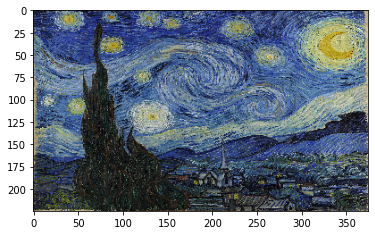

In [9]:
plt.imshow(sample_image)

In [10]:
type(sample_image)

PIL.Image.Image

In [11]:
sample_image = np.array(sample_image) / 255.0
sample_image.shape

(225, 375, 3)

In [12]:
type(sample_image)

numpy.ndarray

In [13]:
sample_image.max()

1.0

In [14]:
sample_image.min()

0.0

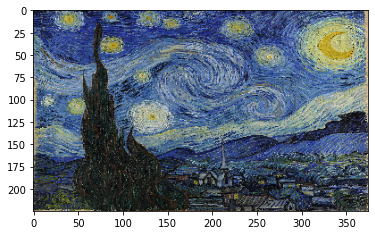

In [15]:
plt.imshow(sample_image)

# Etapa 4: Executar o modelo pré-treinado e explorar as ativações

In [16]:
sample_image = tf.keras.preprocessing.image.img_to_array(sample_image)
sample_image.shape

(225, 375, 3)

In [17]:
type(sample_image)

numpy.ndarray

In [18]:
sample_image = tf.Variable(tf.keras.applications.inception_v3.preprocess_input(sample_image))

In [19]:
type(sample_image)

tensorflow.python.ops.resource_variable_ops.ResourceVariable

In [20]:
sample_image = tf.expand_dims(sample_image, axis = 0)
np.shape(sample_image)

TensorShape([1, 225, 375, 3])

In [21]:
sample_image.shape

TensorShape([1, 225, 375, 3])

In [22]:
activations = deepdream_model(sample_image)

In [23]:
len(activations)

2

In [24]:
activations[1]

<tf.Tensor: shape=(1, 12, 21, 768), dtype=float32, numpy=
array([[[[3.3623009 , 4.190622  , 3.9559462 , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 3.2915673 , ..., 0.        ,
          0.        , 0.        ],
         [1.1932634 , 2.8545084 , 0.9676061 , ..., 0.        ,
          0.        , 0.        ],
         ...,
         [0.04280951, 1.3122513 , 1.0145411 , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 2.0416918 , ..., 0.        ,
          0.        , 0.0436179 ],
         [1.5414286 , 1.8796754 , 1.8178895 , ..., 0.        ,
          0.        , 0.19873527]],

        [[1.1934952 , 2.150277  , 2.3389983 , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 4.645838  , ..., 0.        ,
          0.        , 0.        ],
         [0.21733533, 1.68917   , 0.23644242, ..., 0.        ,
          0.        , 0.        ],
         ...,
         [0.        , 0.452390

# Etapa 5: Cálculo da loss

- Calcularemos a loss que representa o somatório das ativações de uma camada específica
- Na maioria das vezes o objetivo é minizar o erro (loss) usando a descida gradiente, porém, em deep dream o objetivo é maximizar a loss 
- Isso é feito usando subida do gradiente (gradient ascent)
- A função encaminha a imagem pela rede neural e gera as ativações. Depois obtemos a soma das saídas
 

In [25]:
def calc_loss(image, model, test = 1):
  if test == 1:
    img_batch = tf.expand_dims(image, axis = 0)
    layer_activations = model(img_batch)
  else:
    layer_activations = model(image)

  losses = []
  for act in layer_activations:
    loss = tf.math.reduce_mean(act)
    losses.append(loss)

  print('Losses from multiple activation layers = ', losses)
  print('Losses shape = ', np.shape(losses))
  print('Sum of all losses = ', tf.reduce_sum(losses))

  return tf.reduce_sum(losses)

In [26]:
loss = calc_loss(sample_image, deepdream_model, test = 0)
loss

Losses from multiple activation layers =  [<tf.Tensor: shape=(), dtype=float32, numpy=0.2634555>, <tf.Tensor: shape=(), dtype=float32, numpy=0.17727213>]
Losses shape =  (2,)
Sum of all losses =  tf.Tensor(0.44072765, shape=(), dtype=float32)


<tf.Tensor: shape=(), dtype=float32, numpy=0.44072765>

# Etapa 6: Subida do gradiente

- Vamos utilizar a loss calculada no passo anterior e calcular o gradiente com respeito a imagem de entrada. Depois adicionamos os valores na imagem de entrada


In [27]:
@tf.function
def deepdream(model, image, step_size):
  with tf.GradientTape() as tape:
    tape.watch(image)
    loss = calc_loss(image, model)

  gradients = tape.gradient(loss, image)
  gradients /= tf.math.reduce_std(gradients)
  image = image + gradients * step_size
  image = tf.clip_by_value(image, -1, 1)

  return loss, image

In [28]:

def run_deep_dream_simple(model, image, steps = 100, step_size = 0.01):
  image = tf.keras.applications.inception_v3.preprocess_input(image)
  for step in range(steps):
    loss, image = deepdream(model, image, step_size)

    if step % 100 == 0:
      plt.figure(figsize=(12,12))
      plt.imshow(deprocess(image))
      plt.show()
      print('Step {}, loss {}'.format(step, loss))
  
  plt.figure(figsize=(12,12))
  plt.imshow(deprocess(image))
  plt.show()

  return deprocess(image)

In [29]:
def deprocess(image):
  image = 255 * (image + 1.0) / 2.0
  return tf.cast(image, tf.uint8)

# Etapa 7: Primeiro teste

In [30]:
test_image = tf.keras.preprocessing.image.load_img(r'/content/StaryNight.jpg',
                                                     target_size = (225, 375))
test_image = np.array(test_image)
#test_image = tf.keras.applications.inception_v3.preprocess_input(test_image)

In [31]:
np.shape(test_image)

(225, 375, 3)

Losses from multiple activation layers =  [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>]
Losses shape =  (2,)
Sum of all losses =  Tensor("Sum:0", shape=(), dtype=float32)


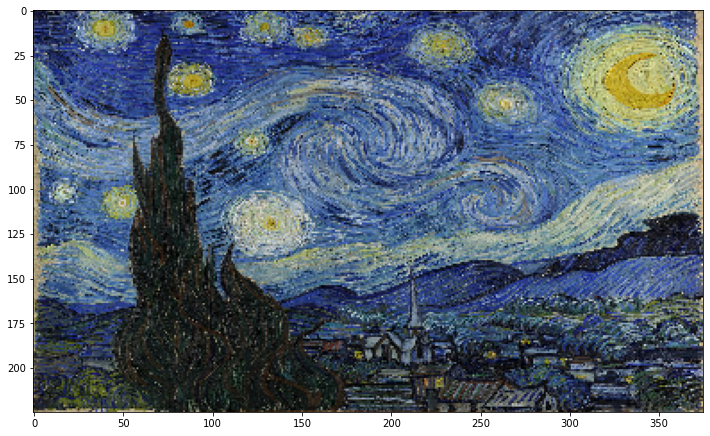

Step 0, loss 0.6168045401573181


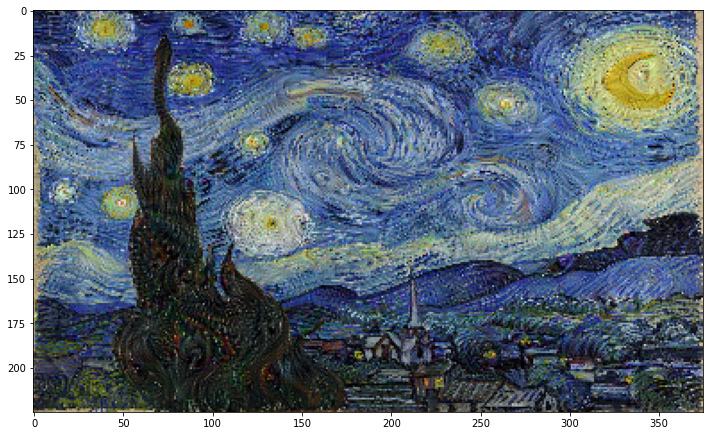

Step 100, loss 1.4080549478530884


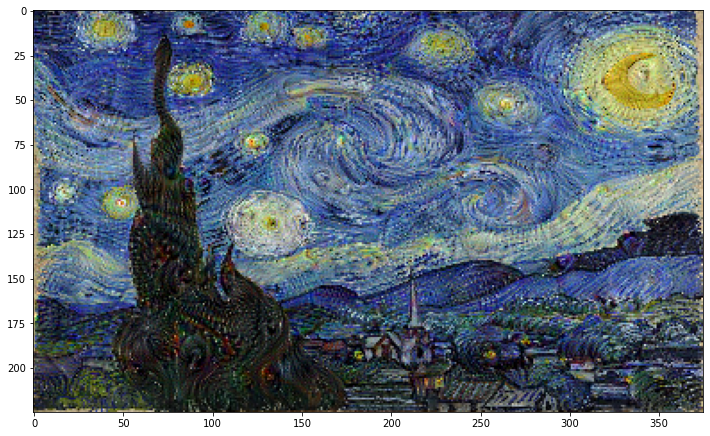

Step 200, loss 1.7218066453933716


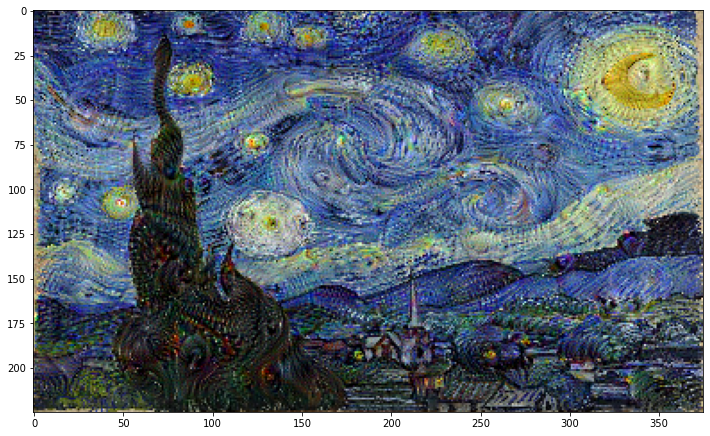

Step 300, loss 1.9085614681243896


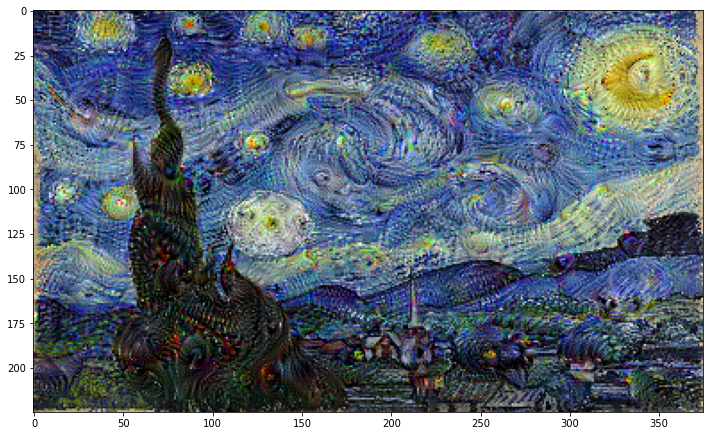

Step 400, loss 2.0468790531158447


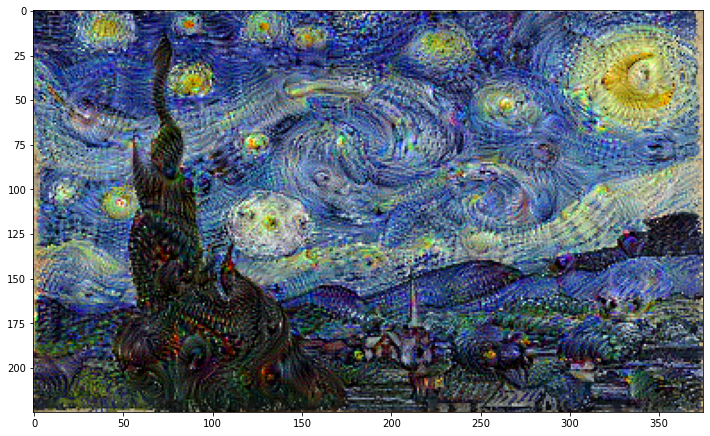

Step 500, loss 2.155953884124756


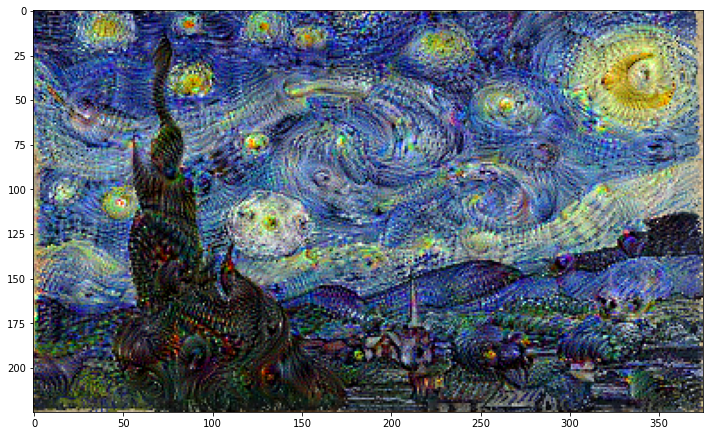

Step 600, loss 2.2492570877075195


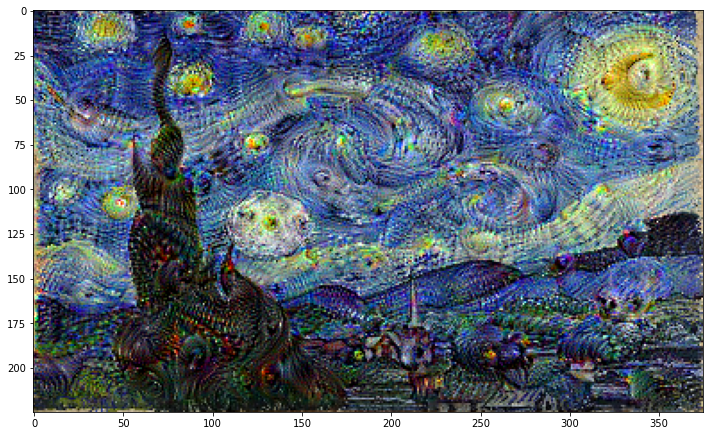

Step 700, loss 2.332364082336426


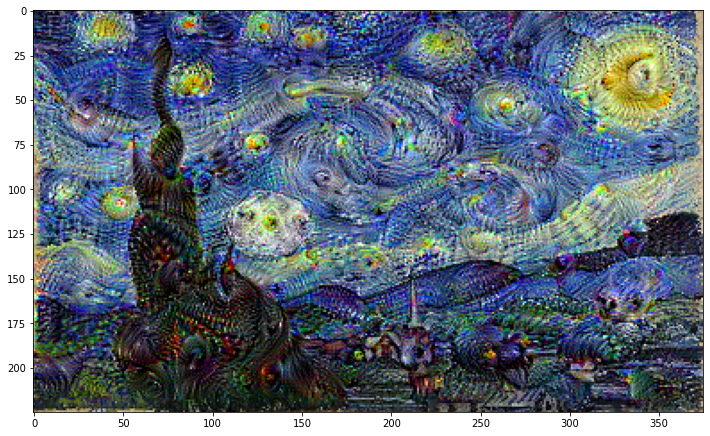

Step 800, loss 2.4060921669006348


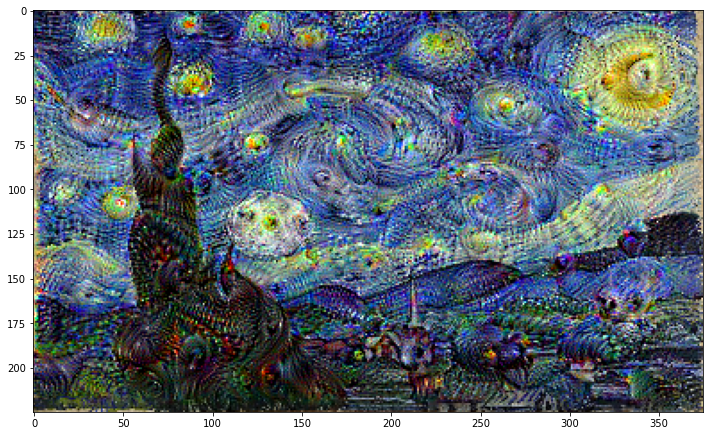

Step 900, loss 2.473353624343872


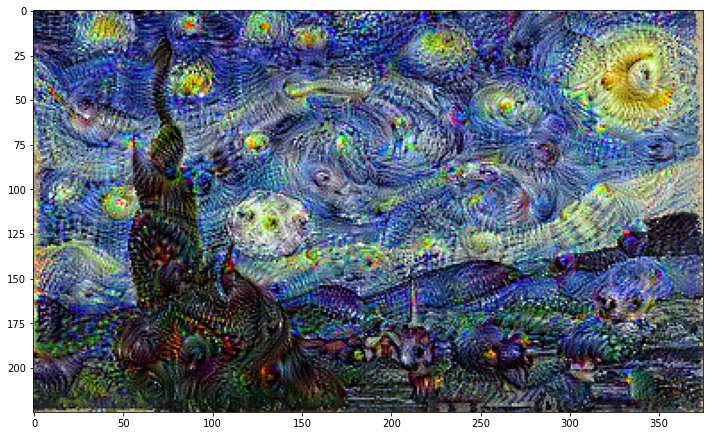

Step 1000, loss 2.5354063510894775


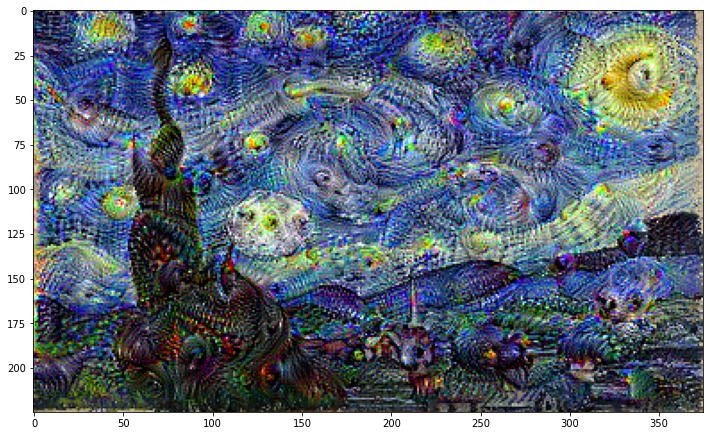

Step 1100, loss 2.5934665203094482


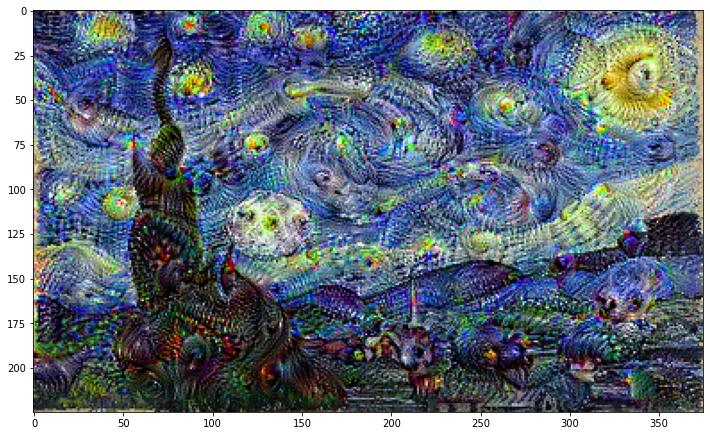

Step 1200, loss 2.648982048034668


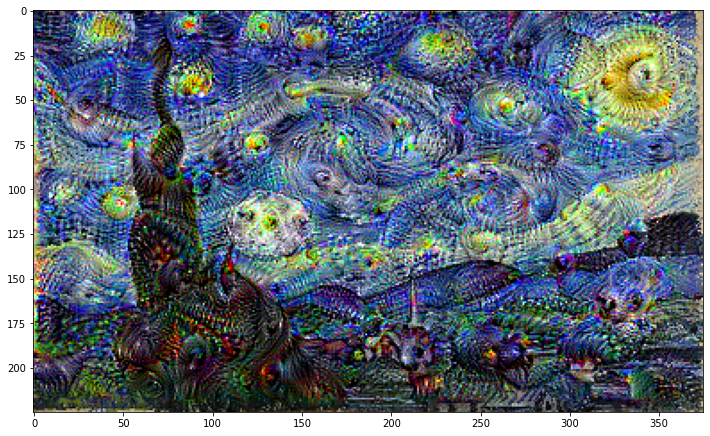

Step 1300, loss 2.700977325439453


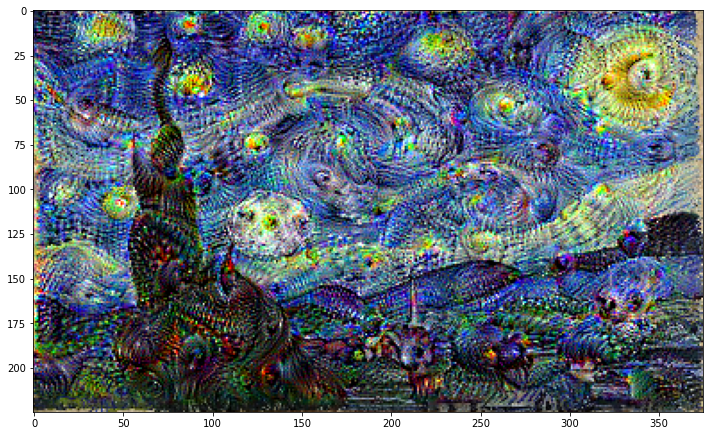

Step 1400, loss 2.74983286857605


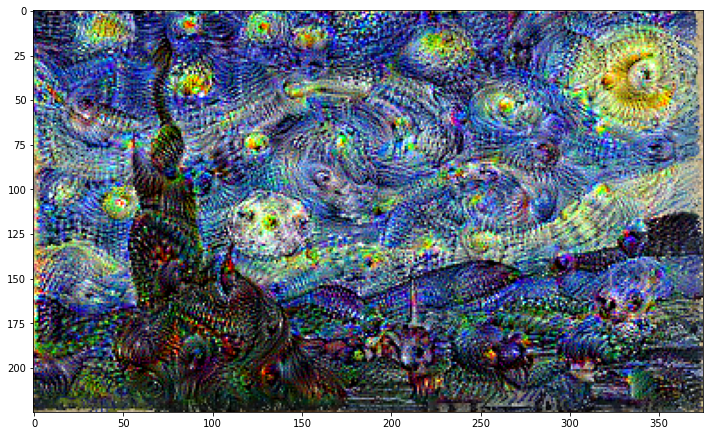

Step 1500, loss 2.7958998680114746


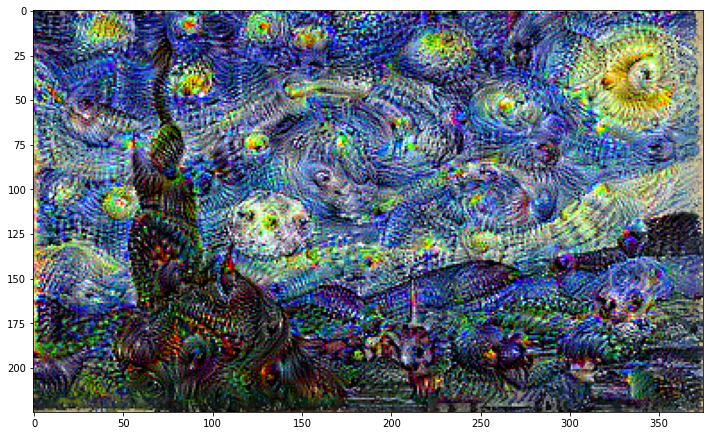

Step 1600, loss 2.8396987915039062


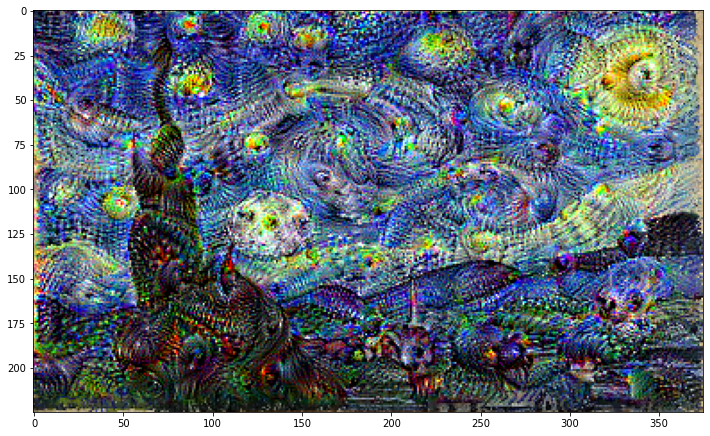

Step 1700, loss 2.8804984092712402


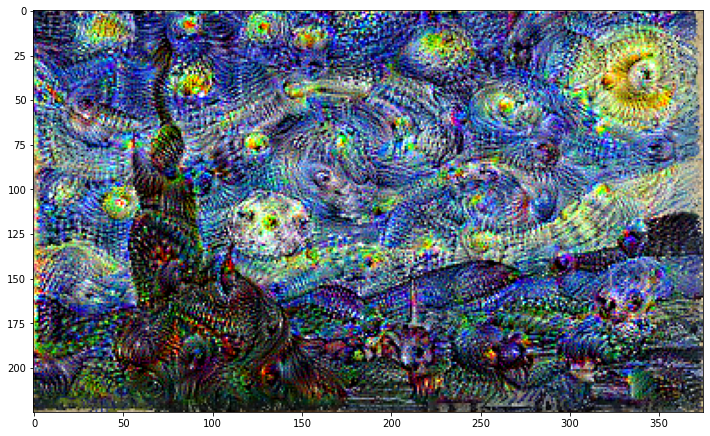

Step 1800, loss 2.919023275375366


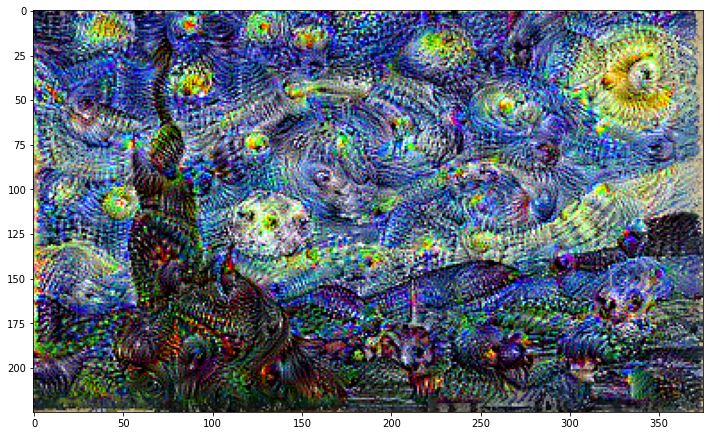

Step 1900, loss 2.9557673931121826


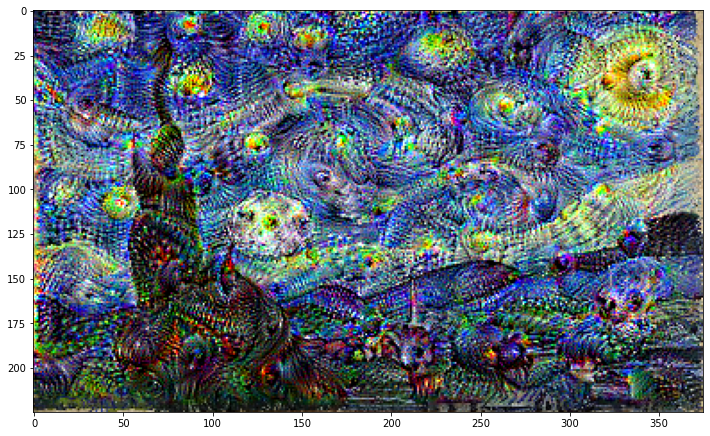

In [32]:
dream_img = run_deep_dream_simple(model = deepdream_model, 
                                  image = test_image,
                                  steps = 2000, step_size = 0.001)

# Etapa 8: Executando em mais dimensões

In [33]:
escala = 1.3
test_image2 = tf.keras.preprocessing.image.load_img(r'/content/sky.jpeg',
                                                     target_size = (225, 375))
#test_image2 = np.array(test_image2)
#test_image2 = tf.keras.applications.inception_v3.preprocess_input(test_image2)

image = tf.constant(np.array(test_image2))
base_shape = tf.cast(tf.shape(image)[:-1], tf.float32)

In [34]:
type(image)

tensorflow.python.framework.ops.EagerTensor

In [35]:
np.shape(image)

TensorShape([225, 375, 3])

In [36]:
type(base_shape)

tensorflow.python.framework.ops.EagerTensor

In [37]:
np.shape(base_shape)

TensorShape([2])

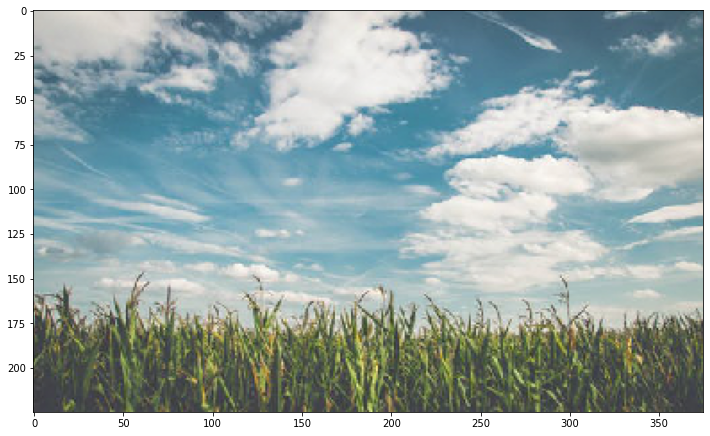

Step 0, loss 0.6144235134124756


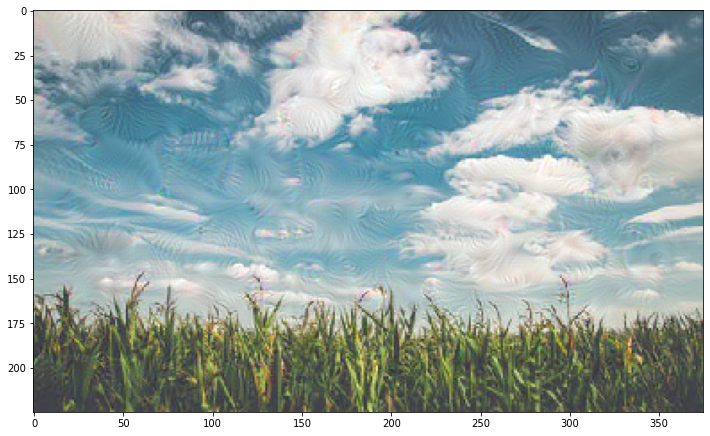

Step 100, loss 1.3862802982330322


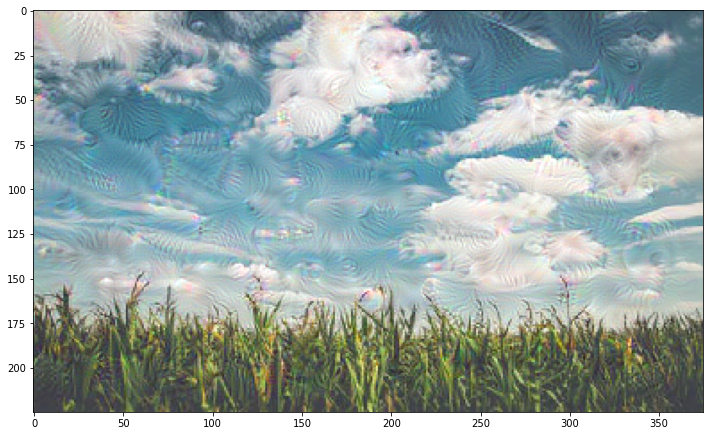

Step 200, loss 1.635969638824463


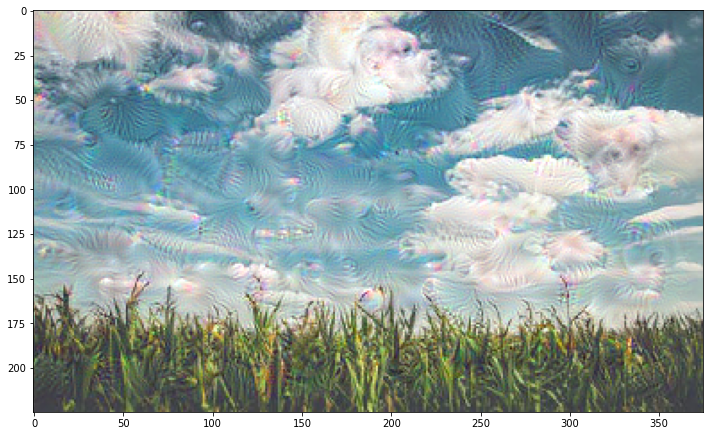

Step 300, loss 1.7868492603302002


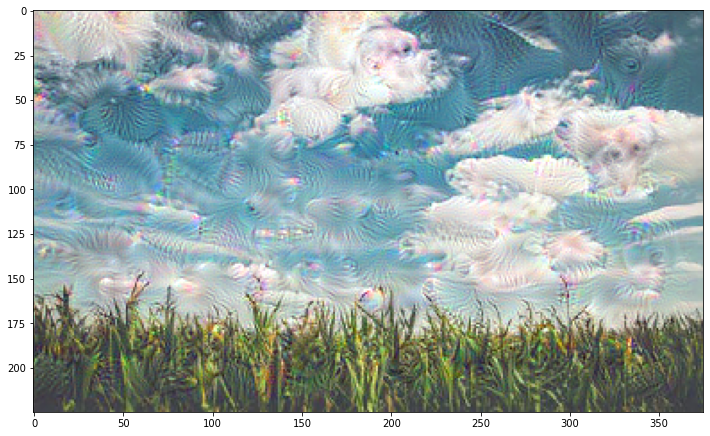

Losses from multiple activation layers =  [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>]
Losses shape =  (2,)
Sum of all losses =  Tensor("Sum:0", shape=(), dtype=float32)


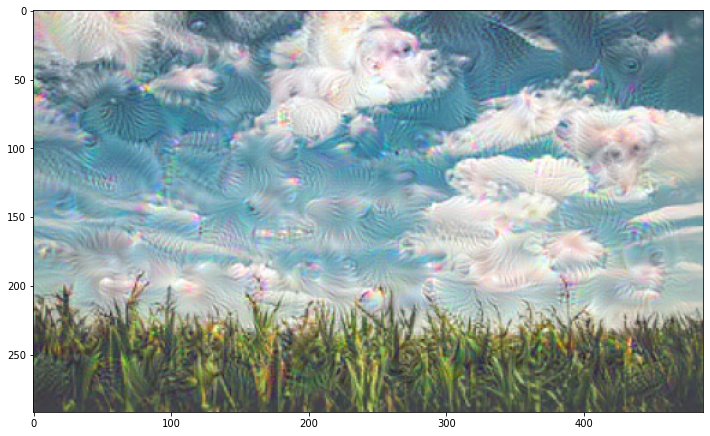

Step 0, loss 0.8999756574630737


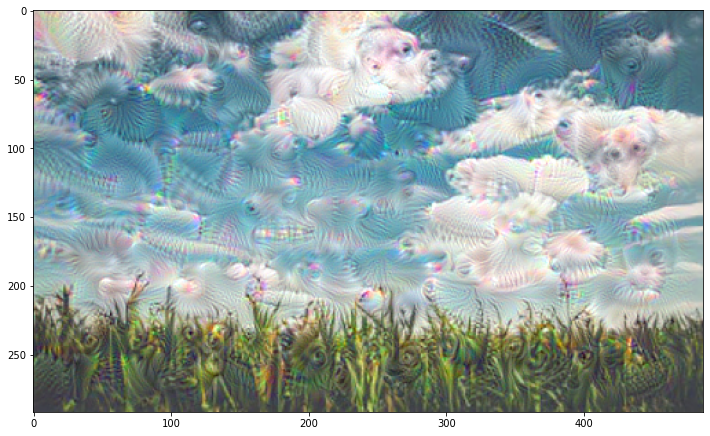

Step 100, loss 1.6219027042388916


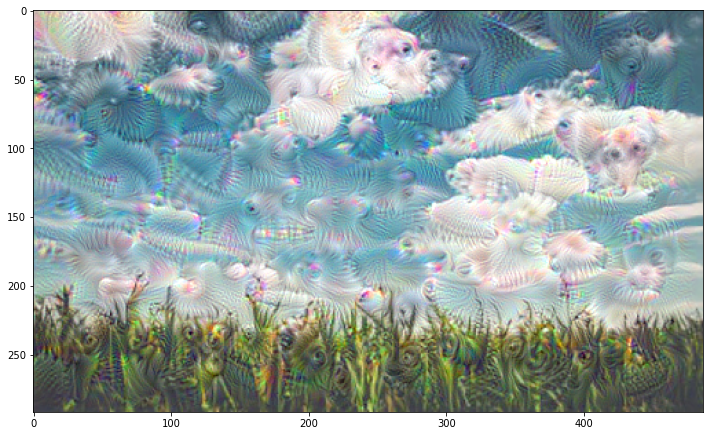

Step 200, loss 1.8179783821105957


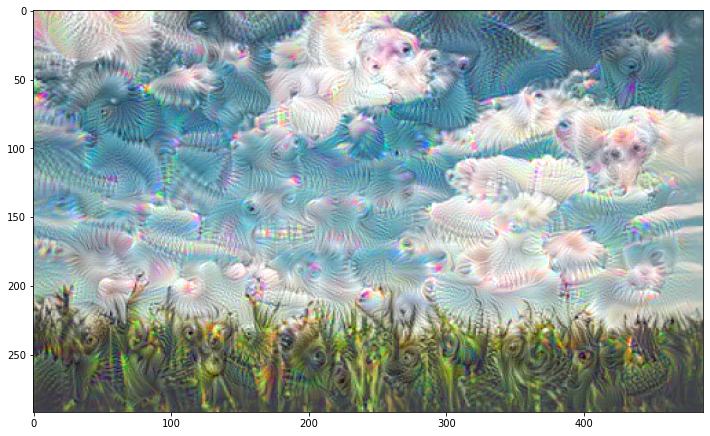

Step 300, loss 1.941849946975708


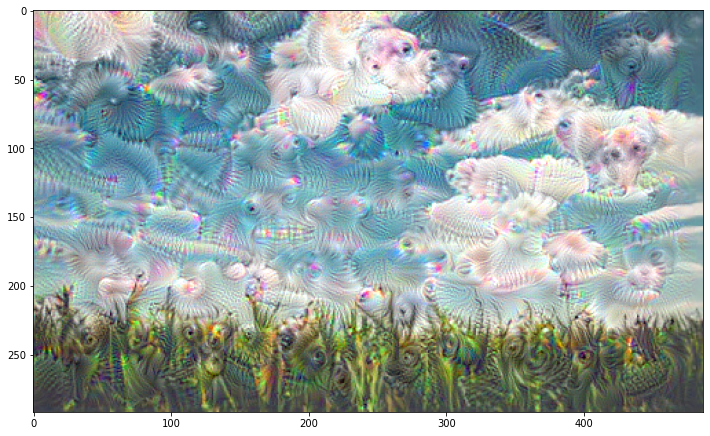

Losses from multiple activation layers =  [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>]
Losses shape =  (2,)
Sum of all losses =  Tensor("Sum:0", shape=(), dtype=float32)


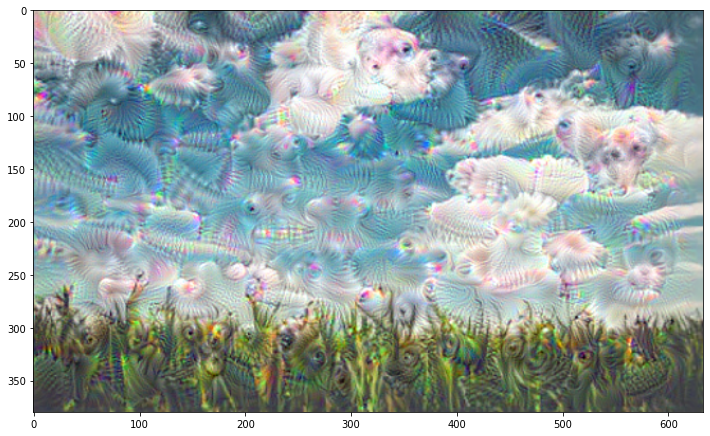

Step 0, loss 0.933989405632019


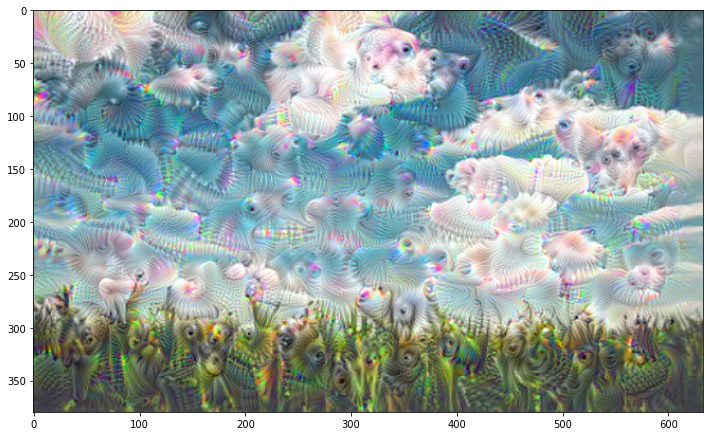

Step 100, loss 1.6615557670593262


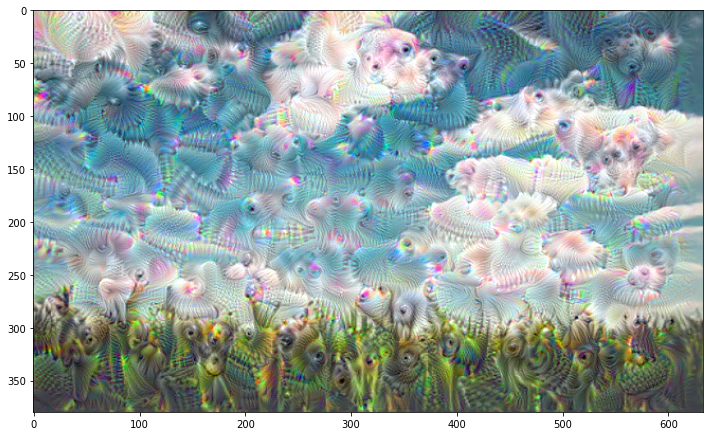

Step 200, loss 1.862234115600586


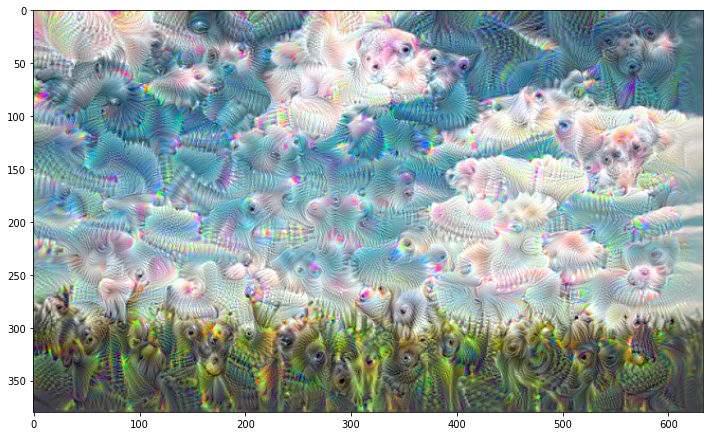

Step 300, loss 1.9861921072006226


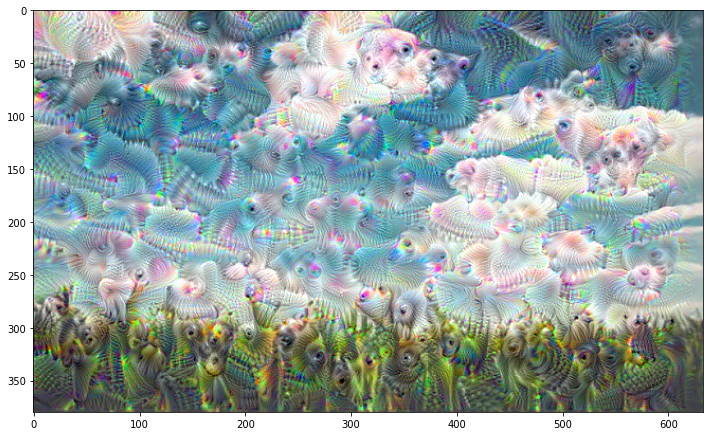

Losses from multiple activation layers =  [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>]
Losses shape =  (2,)
Sum of all losses =  Tensor("Sum:0", shape=(), dtype=float32)


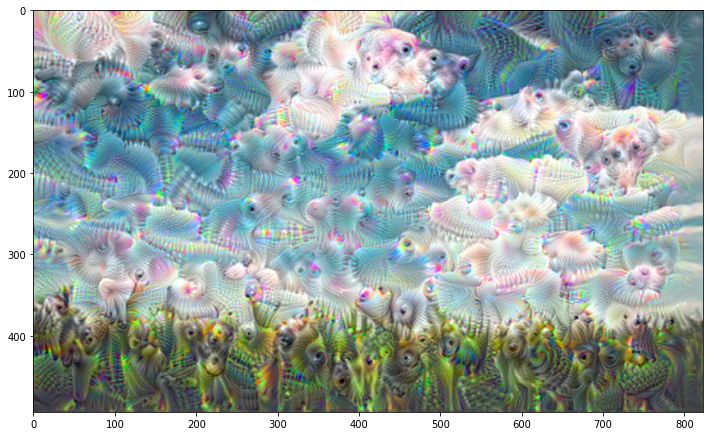

Step 0, loss 0.9382598996162415


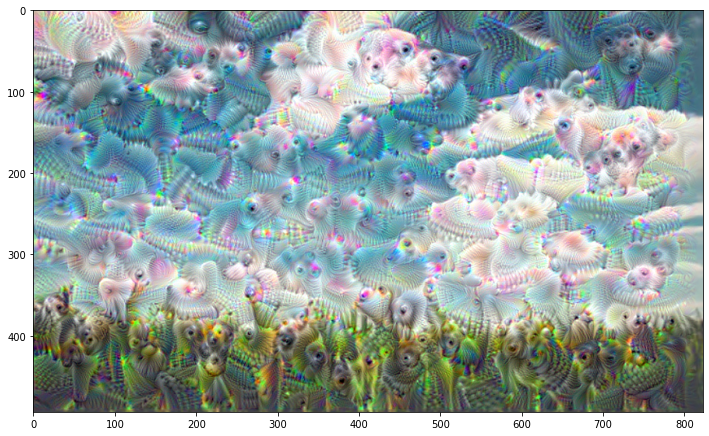

Step 100, loss 1.6785502433776855


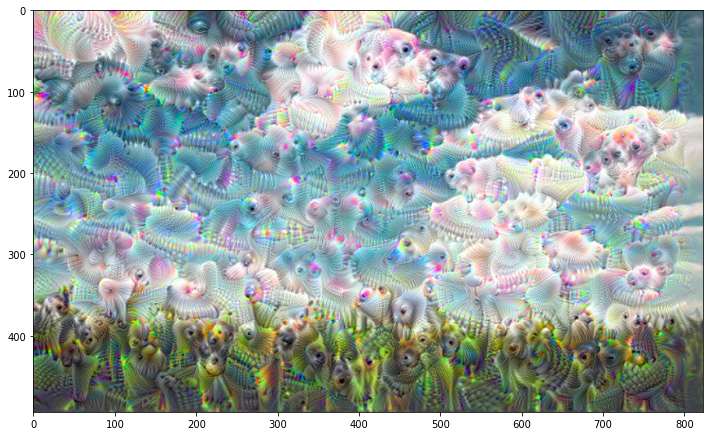

Step 200, loss 1.8818414211273193


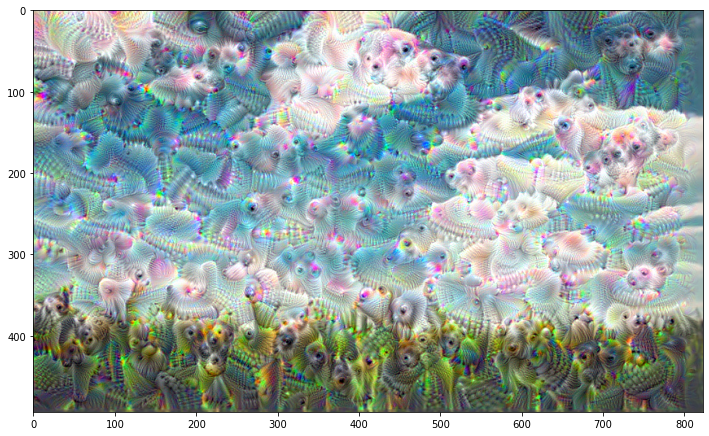

Step 300, loss 2.0059666633605957


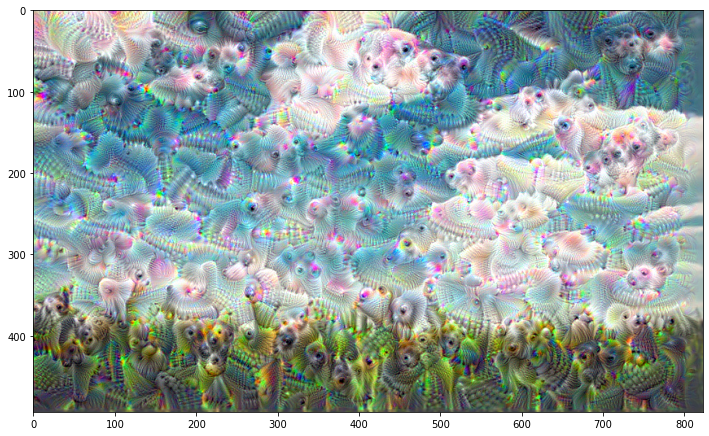

Losses from multiple activation layers =  [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>]
Losses shape =  (2,)
Sum of all losses =  Tensor("Sum:0", shape=(), dtype=float32)


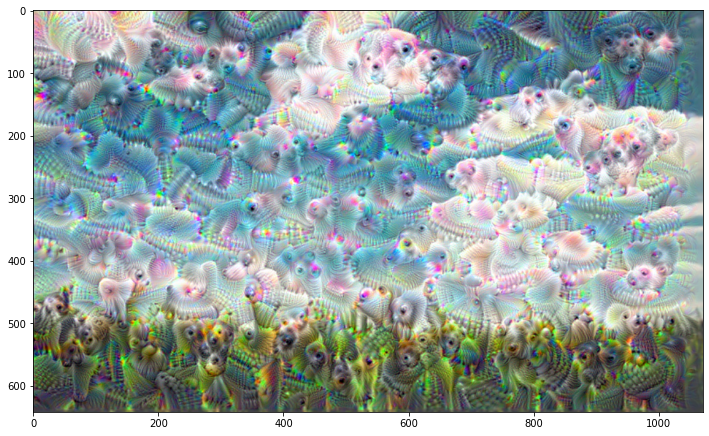

Step 0, loss 0.9353268146514893


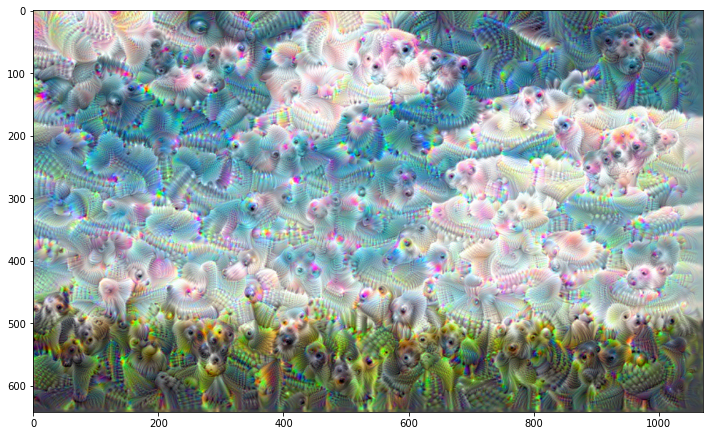

Step 100, loss 1.674102544784546


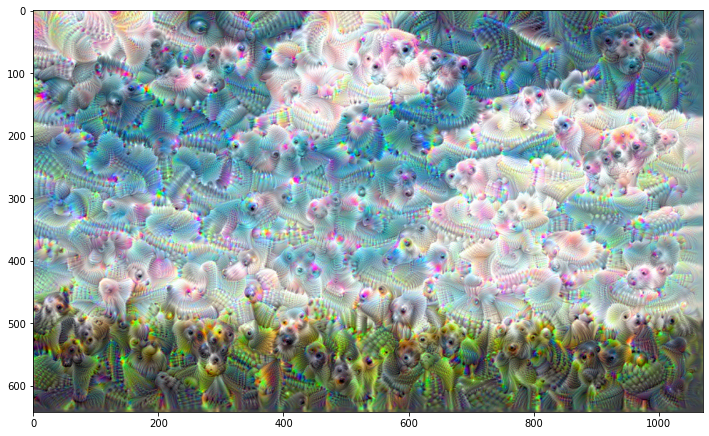

Step 200, loss 1.8783833980560303


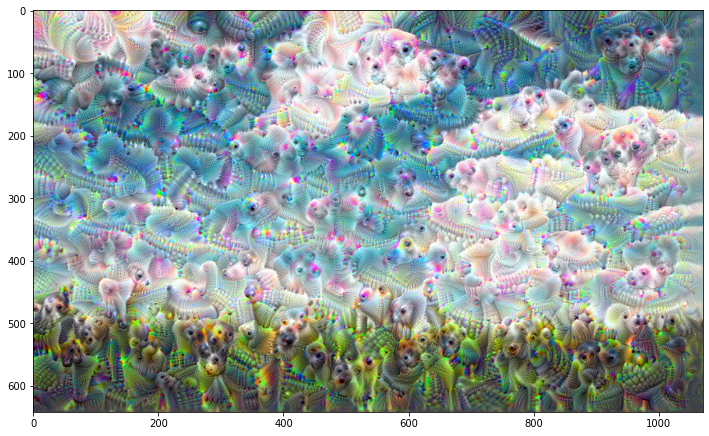

Step 300, loss 2.0037803649902344


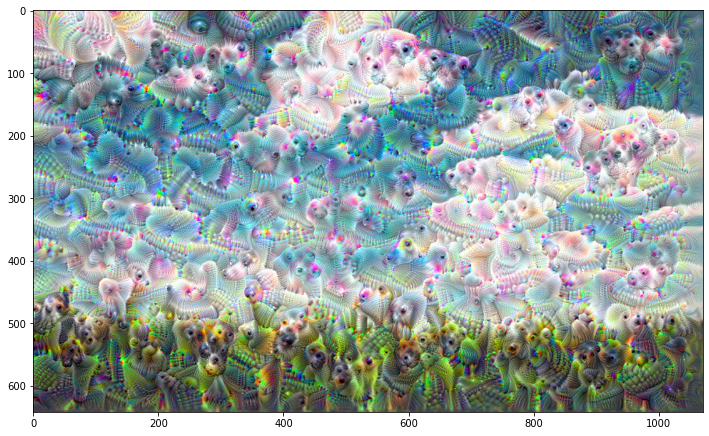

In [38]:
for n in range(5):
  new_shape = tf.cast(base_shape * (escala**n), tf.int32)
  image = tf.image.resize(image, new_shape).numpy()
  image = run_deep_dream_simple(model=deepdream_model,image = image,
                                steps = 400, step_size = 0.001)